In [1]:
using FileIO
using Images
using ScikitLearn
using Statistics
using Flux
using Flux: onehotbatch, onecold, crossentropy, binarycrossentropy
using Random
using DelimitedFiles
using ImageView, Images, ImageSegmentation
using Random

@sk_import svm: SVC

using Random

include("funcionesUtiles.jl");

┌ Info: Precompiling ScikitLearn [3646fa90-6ef7-5e7e-9f22-8aca16db6324]
└ @ Base loading.jl:1273
┌ Info: CUDAnative.jl failed to initialize, GPU functionality unavailable (set JULIA_CUDA_SILENT or JULIA_CUDA_VERBOSE to silence or expand this message)
└ @ CUDAnative /home/manuc/.julia/packages/CUDAnative/JfXpo/src/CUDAnative.jl:146
Gtk-Message: 13:26:43.386: Failed to load module "canberra-gtk-module"
Gtk-Message: 13:26:43.386: Failed to load module "canberra-gtk-module"


In [2]:
function process_image(image, n_inputs)
    img_CHW = channelview(image);
    patron = zeros(n_inputs);
    
    patron[1] = mean(img_CHW[1,:,:]);
    patron[2] = mean(img_CHW[2,:,:]);
    patron[3] = mean(img_CHW[3,:,:]);
    patron[4] = std(img_CHW[1,:,:]);
    patron[5] = std(img_CHW[2,:,:]);
    patron[6] = std(img_CHW[3,:,:]);

    #return reshape(patron,n_inputs,1);
    return patron;
end;

In [3]:
function prepare_data(dir, n_inputs, output)
    directorio = readdir(dir);
    patrones = zeros(n_inputs, size(directorio,1));
    salidas_deseadas = zeros(1, size(directorio,1));
    
    i = 1
    for file in directorio 
        image = load(string(dir,"/",file));
        patrones[:,i] = process_image(image, n_inputs)[:];
        salidas_deseadas[i] = output;
        i = i + 1
    end;

    return patrones, salidas_deseadas;
end;

In [4]:
function svm_training(patrones, salidasDeseadas, porcentajeTest, numEjecuciones, kernel, C_arg = 1, gamma_arg = 2,degree_arg = 2)
    numPatrones = size(patrones,1) #Depende de si se distribuyen en filas o columnas
    mejorModelo = SVC();
    mejorPuntuacion = 0.0;
    
    # Creamos un par de vectores vacios donde vamos a ir guardando los resultados de cada ejecucion
    precisionesEntrenamiento = Array{Float64,1}();
    precisionesTest = Array{Float64,1}();
    
    maxPT=0
    for numEjecucion in 1:numEjecuciones
        println("Ejecucion ", numEjecucion);

        (indicesPatronesEntrenamiento, indicesPatronesTest) = holdOut(numPatrones, porcentajeTest);

        # Creamos el SVM
        if(kernel == "linear")
            modelo = SVC(kernel="linear", C=C_arg);
            println("Lineal")
        elseif(kernel == "rbf")
            modelo = SVC(gamma=gamma_arg, C=C_arg);
            println("rbf")
        elseif(kernel =="poly")
            modelo = SVC(kernel="linear", degree=degree_arg, C=C_arg);
            println("poly")
        end;
        
        
        # Ajustamos el modelo, solo con los patrones de entrenamiento
        fit!(modelo, patrones[indicesPatronesEntrenamiento,:], salidasDeseadas[indicesPatronesEntrenamiento]);

        # Calculamos la clasificacion de los patrones de entrenamiento
        clasificacionEntrenamiento = predict(modelo, patrones[indicesPatronesEntrenamiento,:]);
        # Calculamos las distancias al hiperplano de esos mismos patrones
        distanciasHiperplano = decision_function(modelo, patrones[indicesPatronesEntrenamiento,:]);
        # Calculamos la precision en el conjunto de entrenamiento y la mostramos por pantalla
        precisionEntrenamiento = 100*mean(clasificacionEntrenamiento .== salidasDeseadas[indicesPatronesEntrenamiento]);
        println("   Precision en el conjunto de entrenamiento: $precisionEntrenamiento %");

        # Calculamos la clasificacion de los patrones de test
        clasificacionTest = predict(modelo, patrones[indicesPatronesTest,:]);
        # Calculamos las distancias al hiperplano de esos mismos patrones
        distanciasHiperplano = decision_function(modelo, patrones[indicesPatronesTest,:]);
        # Calculamos la precision en el conjunto de test y la mostramos por pantalla
        precisionTest = 100*mean(clasificacionTest .== salidasDeseadas[indicesPatronesTest]);
        println("   Precision en el conjunto de test: $precisionTest %");
        
        if precisionTest > maxPT
            maxPT = precisionTest
            mejorModelo = modelo
        end;

        # Y guardamos esos valores de precision obtenidos en esta ejecucion
        push!(precisionesEntrenamiento, precisionEntrenamiento);
        push!(precisionesTest, precisionTest);

    end;
    println("Resultados en promedio de buscar a Nemo:");
    println("   Entrenamiento: ", mean(precisionesEntrenamiento), " %, desviacion tipica: ", std(precisionesEntrenamiento));
    println("   Test:          ", mean(precisionesTest), " %, desviacion tipica: ", std(precisionesTest));
    return mejorModelo;
end;


In [5]:
function get_orange_white_boolean(imagen)
    
    diferenciaRojoVerde = 0.3; 
    diferenciaRojoAzul = 0.3;
    
    canalRojo = red.(imagen); 
    canalVerde = green.(imagen); 
    canalAzul = blue.(imagen);
    
    white_chanel = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.6);
    white_chanel1 = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.9);
    
    mb_w =  (canalRojo.>white_chanel.+ mean(canalRojo)) .& 
            (canalVerde.>white_chanel.- mean(canalVerde)) .& 
            (canalAzul.>white_chanel.- mean(canalAzul));
    
    mb_w1 =  (canalRojo.>white_chanel1) .& 
            (canalVerde.>white_chanel1) .& 
            (canalAzul.>white_chanel1);
    
    mb_r =  (canalRojo.>(canalVerde.+diferenciaRojoVerde)) .& 
            (canalRojo.>(canalAzul.+diferenciaRojoAzul));
    
    matrizBooleana = mb_r .| mb_w1 #.| mb_w1; 
    
    return matrizBooleana;
end;

In [6]:
function check_region(x1, y1, x2, y2, imagen, modelo, nImputs, wall)
    img_v = @view imagen[x1:x2, y1:y2]
    img_CHW = channelview(img_v)

    xtrain = process_image(img_v, nImputs);
    xtrain = reshape(xtrain,1,nImputs)
    #print(predict(modelo,xtrain)[1])
    if(predict(modelo,xtrain)[1] == 1.0)
        imagen[x1:x2, y1] .= RGB(0,1,0);
        imagen[x1:x2, y2] .= RGB(0,1,0);
        imagen[x1, y1:y2] .= RGB(0,1,0);
        imagen[x2, y1:y2] .= RGB(0,1,0);
    else
        imagen[x1:x2, y1] .= RGB(1,0,0);
        imagen[x1:x2, y2] .= RGB(1,0,0);
        imagen[x1, y1:y2] .= RGB(1,0,0);
        imagen[x2, y1:y2] .= RGB(1,0,0);
    end
end

check_region (generic function with 1 method)

In [7]:
function process_picture(filePath, modelo, nImputs, wall)
    imagen = load(filePath);
    #segments_1 = felzenszwalb(imagen, 4);
    #booleanMatrix = get_orange_white_boolean(segment_to_image(segments_1));
    booleanMatrix = get_orange_white_boolean(imagen)
    booleanMatrix = closing(dilate(booleanMatrix,[1,2]))

    if(!maximum(booleanMatrix))
        booleanMatrix = get_orange_white_boolean(imagen);
    end;
    
    labelArray = ImageMorphology.label_components(booleanMatrix);
    boundingBoxes = ImageMorphology.component_boxes(labelArray);
    tamanos = ImageMorphology.component_lengths(labelArray); #Tamaño del grupo 
    pixeles = ImageMorphology.component_indices(labelArray);
    pixeles = ImageMorphology.component_subscripts(labelArray);
    centroides = ImageMorphology.component_centroids(labelArray);

    tamanos = component_lengths(labelArray);
    min_size = (size(imagen)[1]*size(imagen)[2]/600);
    etiquetasEliminar = findall(tamanos .<= min_size) .- 1;
    matrizBooleana = [!in(etiqueta,etiquetasEliminar) && (etiqueta!=0) for etiqueta in labelArray];
    
    labelArray = ImageMorphology.label_components(matrizBooleana);
    imagenObjetos = RGB.(matrizBooleana, matrizBooleana, matrizBooleana);
    centroides = ImageMorphology.component_centroids(labelArray)[2:end];
    
    for centroide in centroides
        x = Int(round(centroide[1]));
        y = Int(round(centroide[2]));
        imagenObjetos[ x, y ] = RGB(1,0,0);
    end;
   
    imagen = load(filePath)
    
    boundingBoxes = ImageMorphology.component_boxes(labelArray)[2:end];
    
    for boundingBox in boundingBoxes
        x1 = boundingBox[1][1];
        y1 = boundingBox[1][2];
        x2 = boundingBox[2][1];
        y2 = boundingBox[2][2];

        check_region(x1,y1,x2,y2, imagen, modelo, nImputs, wall)
    end;
    return imagen;
end;

In [8]:
function shuffle_patterns(patterns, outputs)
    c = hcat(outputs,patterns)
    c = c[shuffle(1:end),:]
    c = c[shuffle(1:end),:]
    return c[:, 2:(size(c)[2])], c[:, 1:1][:,1]
end

shuffle_patterns (generic function with 1 method)

In [9]:
patrones_si, salidas_deseadas_si = prepare_data("../db/positivos", 6, 1);
patrones_no, salidas_deseadas_no = prepare_data("../db/negativos", 6, 0);

patrones = transpose(hcat(patrones_si, patrones_no));
salidasDeseadas = hcat(salidas_deseadas_si, salidas_deseadas_no);
 #‘linear’, ‘poly’, ‘rbf’

mejorModelo = svm_training(patrones, salidasDeseadas,0.2, 50, "linear", 10, 10);



Ejecucion 1
Lineal
   Precision en el conjunto de entrenamiento: 85.51724137931035 %
   Precision en el conjunto de test: 75.0 %
Ejecucion 2
Lineal
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 83.33333333333334 %
Ejecucion 3
Lineal
   Precision en el conjunto de entrenamiento: 86.89655172413792 %
   Precision en el conjunto de test: 75.0 %
Ejecucion 4
Lineal
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 83.33333333333334 %
Ejecucion 5
Lineal
   Precision en el conjunto de entrenamiento: 85.51724137931035 %
   Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 6
Lineal
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 86.11111111111111 %
Ejecucion 7
Lineal
   Precision en el conjunto de entrenamiento: 83.44827586206897 %
   Precision en el conjunto de test: 77.77777777777779 %
Ejecucion 8
Lineal
   Precision 

In [10]:
mejorModelo = svm_training(patrones, salidasDeseadas,0.2, 50, "poly", 10, 10);


Ejecucion 1
poly
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 2
poly
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 86.11111111111111 %
Ejecucion 3
poly
   Precision en el conjunto de entrenamiento: 84.13793103448276 %
   Precision en el conjunto de test: 83.33333333333334 %
Ejecucion 4
poly
   Precision en el conjunto de entrenamiento: 84.82758620689656 %
   Precision en el conjunto de test: 75.0 %
Ejecucion 5
poly
   Precision en el conjunto de entrenamiento: 86.20689655172413 %
   Precision en el conjunto de test: 77.77777777777779 %
Ejecucion 6
poly
   Precision en el conjunto de entrenamiento: 84.13793103448276 %
   Precision en el conjunto de test: 77.77777777777779 %
Ejecucion 7
poly
   Precision en el conjunto de entrenamiento: 86.20689655172413 %
   Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 8
poly
   Precision en 

In [11]:
mejorModelo = svm_training(patrones, salidasDeseadas,0.2, 50, "rbf", 10, 10);

Ejecucion 1
rbf
   Precision en el conjunto de entrenamiento: 93.79310344827586 %
   Precision en el conjunto de test: 91.66666666666666 %
Ejecucion 2
rbf
   Precision en el conjunto de entrenamiento: 93.10344827586206 %
   Precision en el conjunto de test: 94.44444444444444 %
Ejecucion 3
rbf
   Precision en el conjunto de entrenamiento: 94.48275862068965 %
   Precision en el conjunto de test: 86.11111111111111 %
Ejecucion 4
rbf
   Precision en el conjunto de entrenamiento: 94.48275862068965 %
   Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 5
rbf
   Precision en el conjunto de entrenamiento: 93.10344827586206 %
   Precision en el conjunto de test: 88.88888888888889 %
Ejecucion 6
rbf
   Precision en el conjunto de entrenamiento: 95.17241379310344 %
   Precision en el conjunto de test: 86.11111111111111 %
Ejecucion 7
rbf
   Precision en el conjunto de entrenamiento: 97.24137931034483 %
   Precision en el conjunto de test: 80.55555555555556 %
Ejecucion 8
rbf
   Precisio

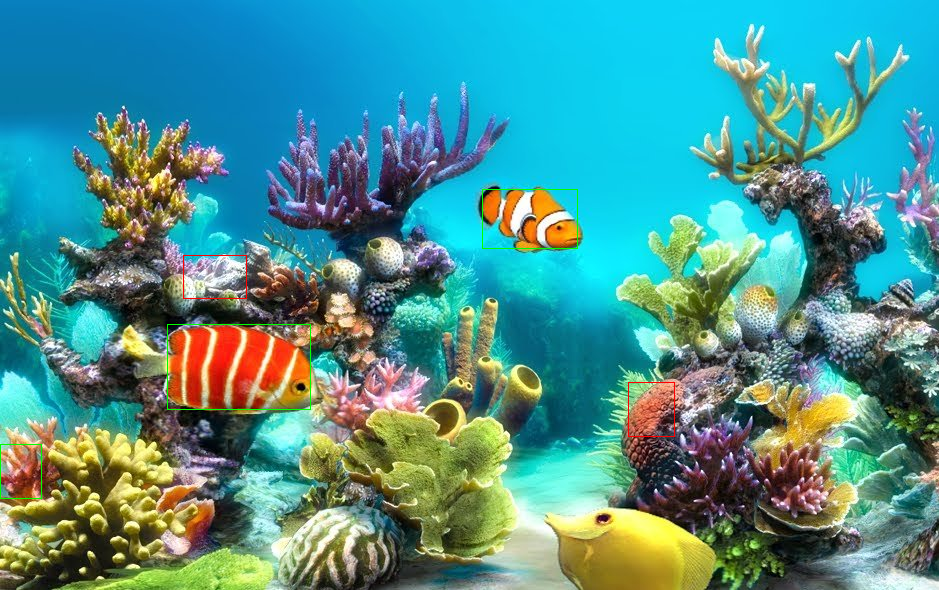

pez001.jpg


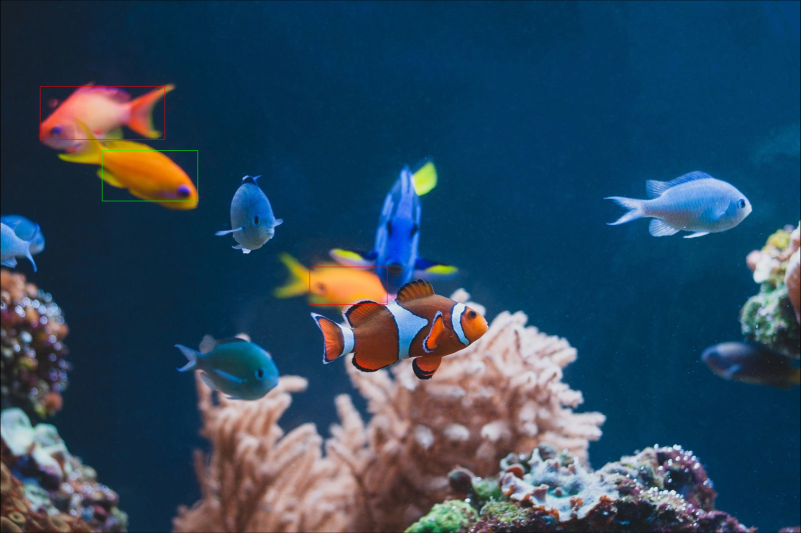

pez002.jpg


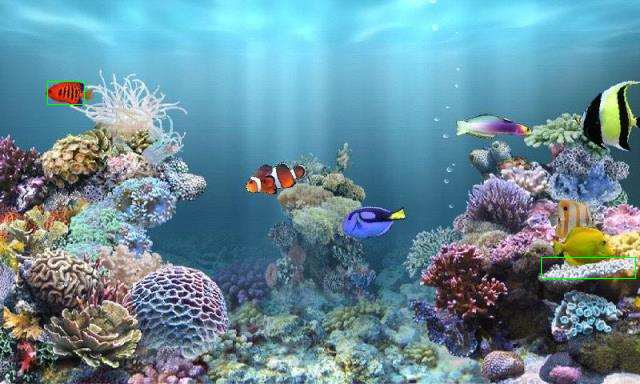

pez003.jpg


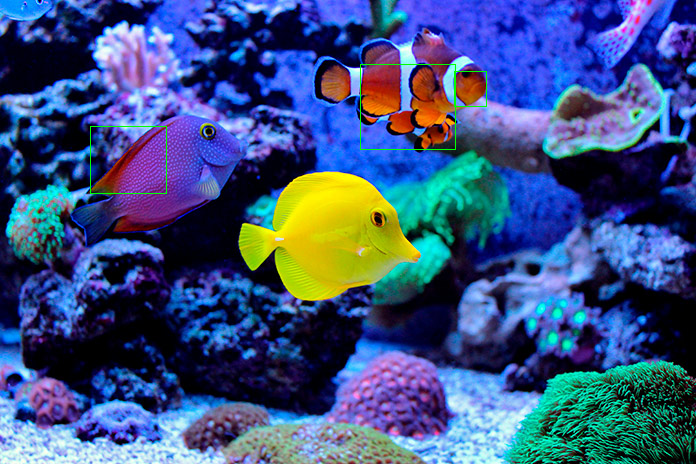

pez004.jpg


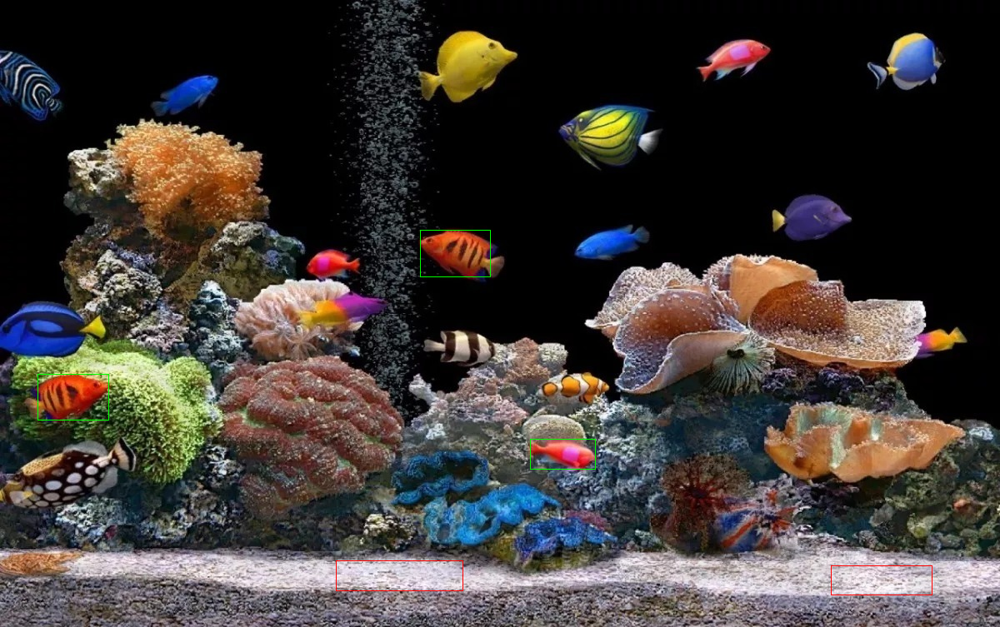

pez005.jpg


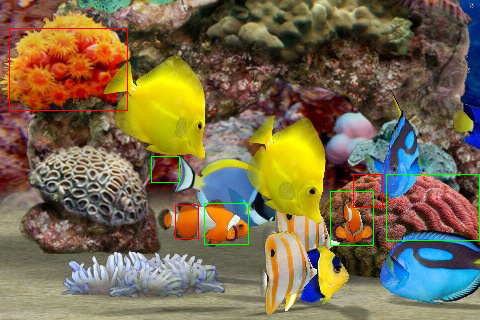

pez006.jpg


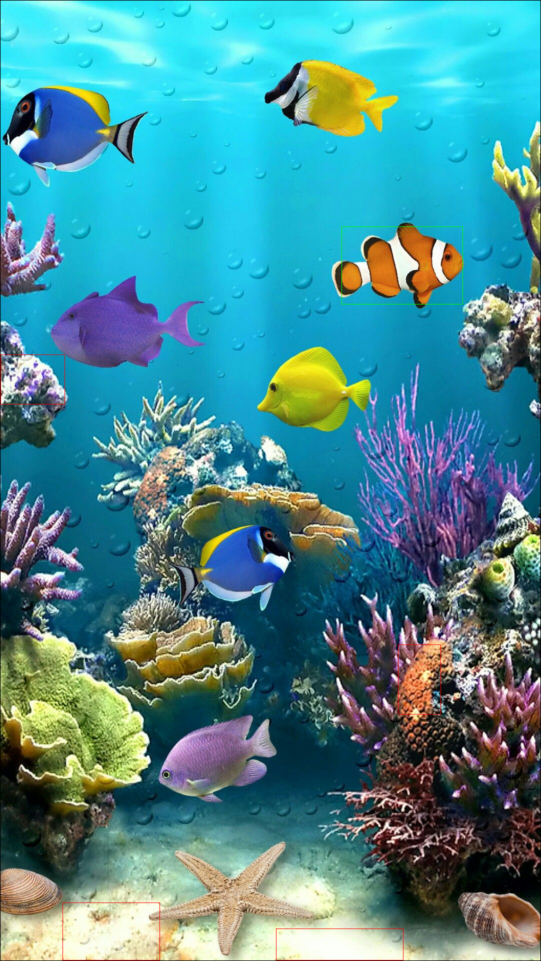

pez007.jpg


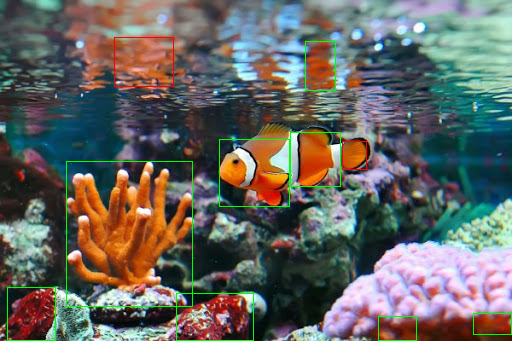

pez008.jpg


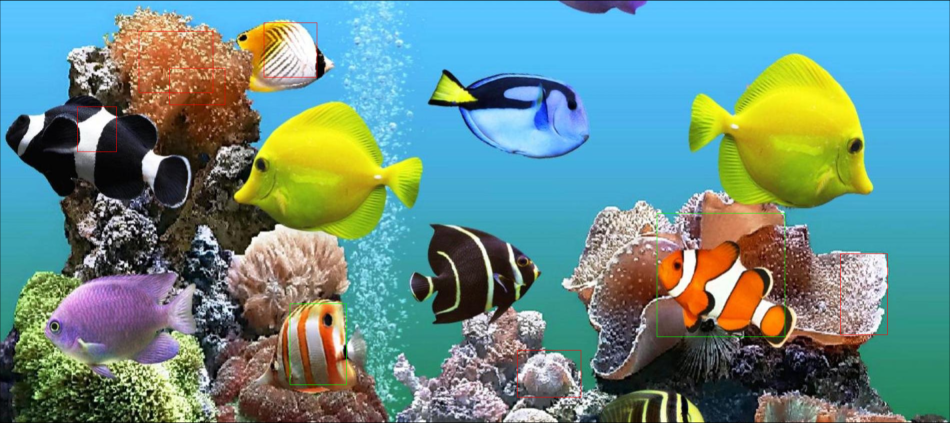

pez009.jpg


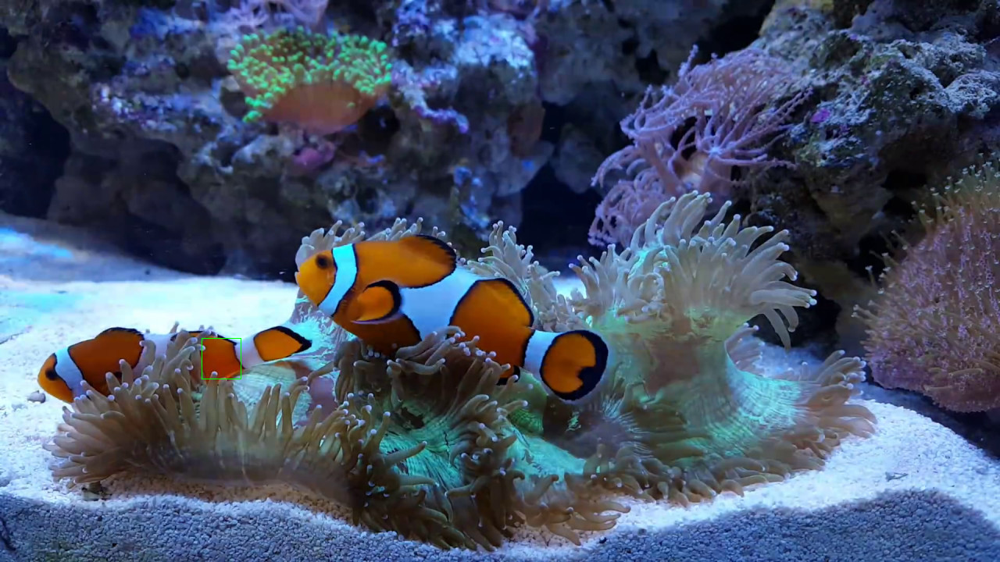

pez010.jpg


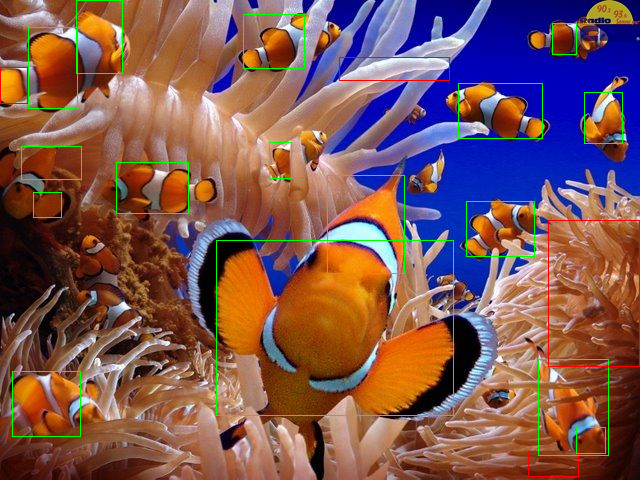

pez011.jpg


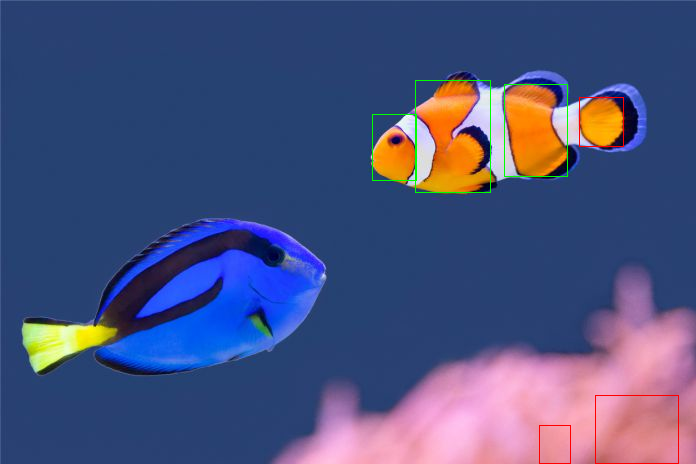

pez012.jpg


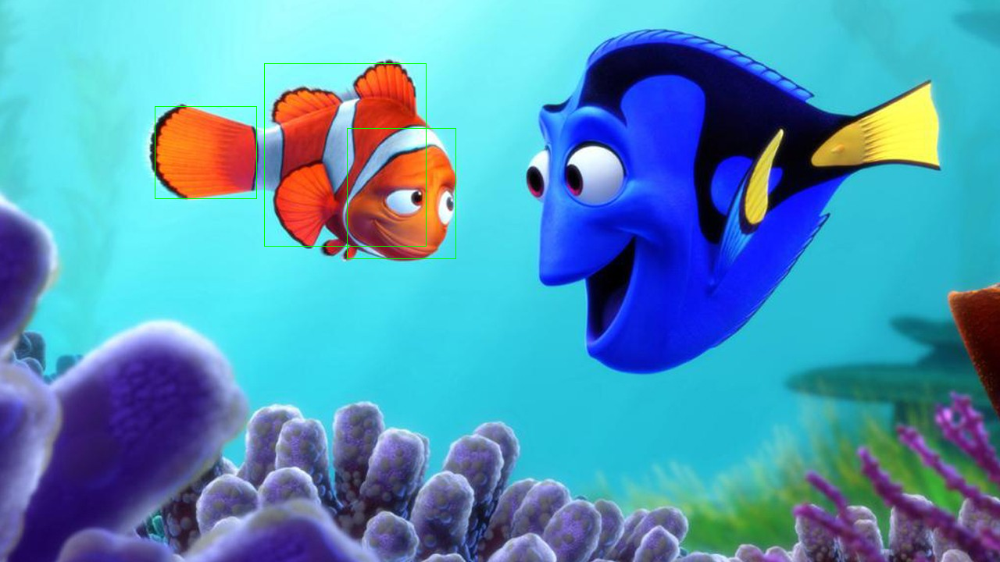

pez013.jpg


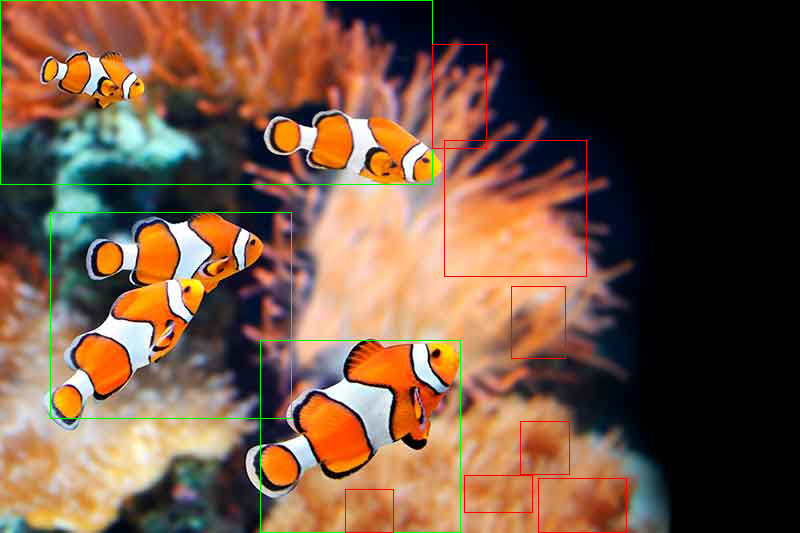

pez014.jpg


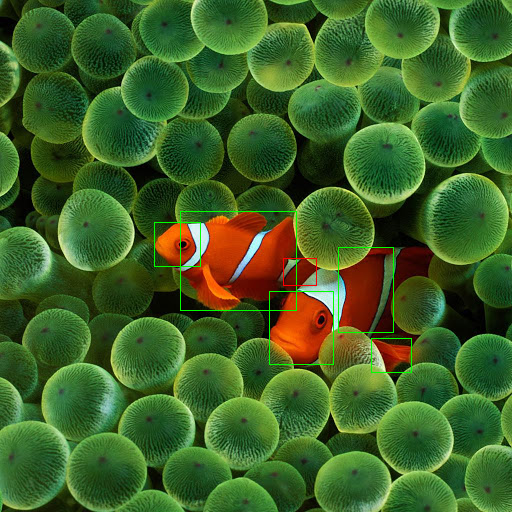

pez015.jpg


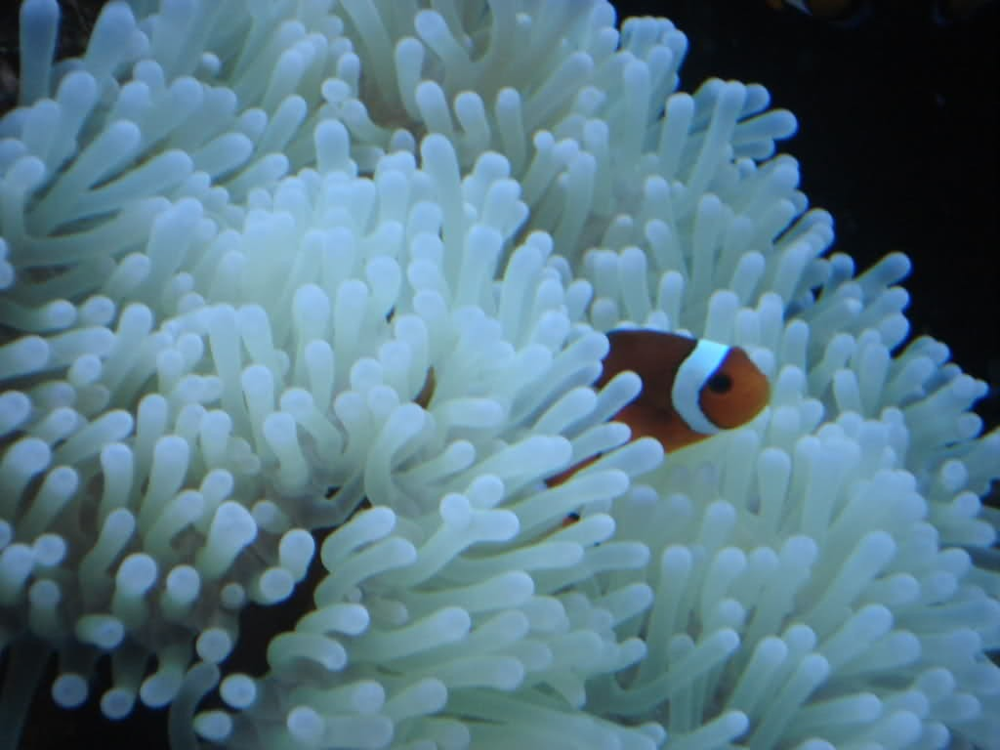

pez016.jpg


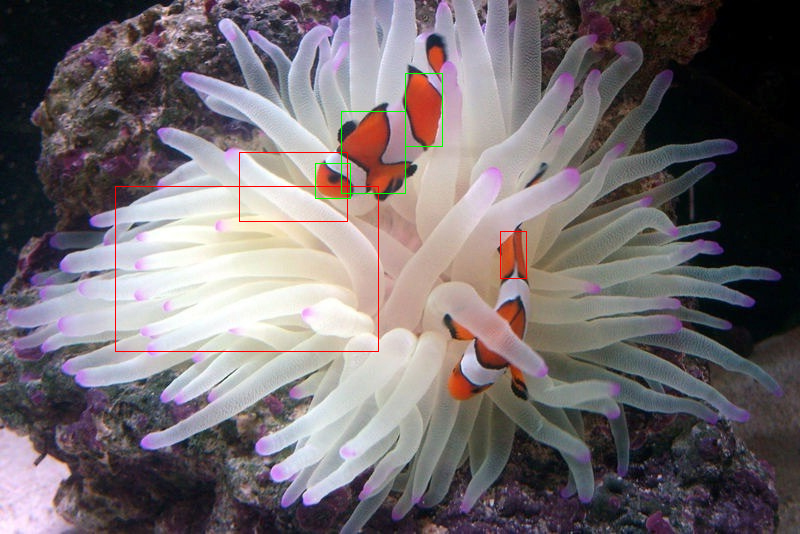

pez017.jpg


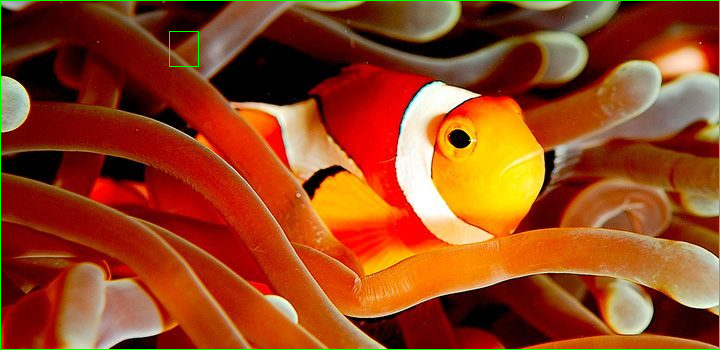

pez018.jpg


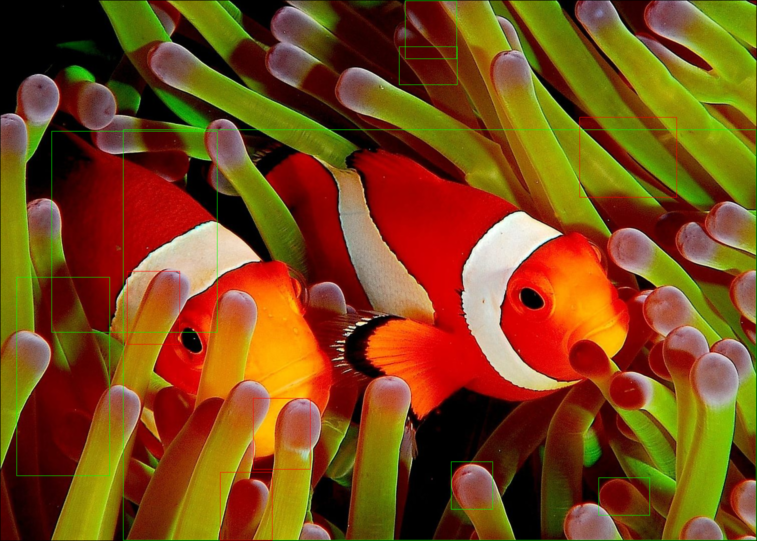

pez019.jpg


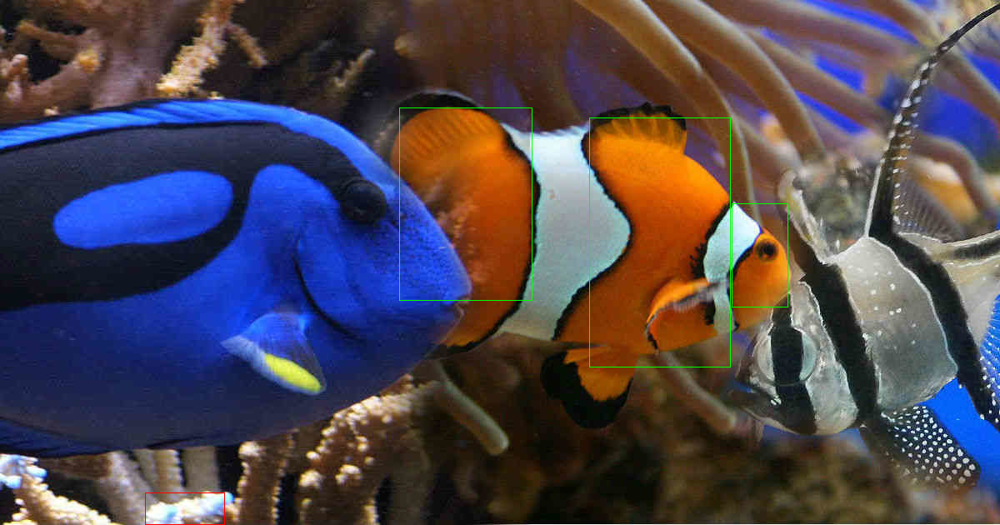

pez020.jpg


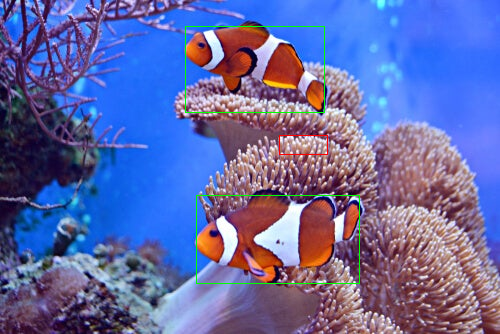

pez021.jpg


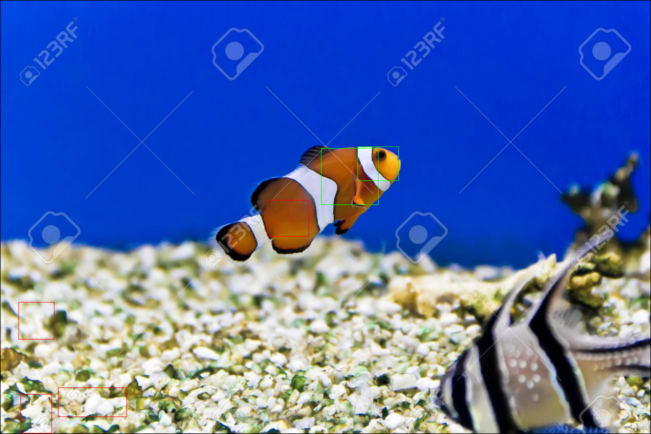

pez022.jpg


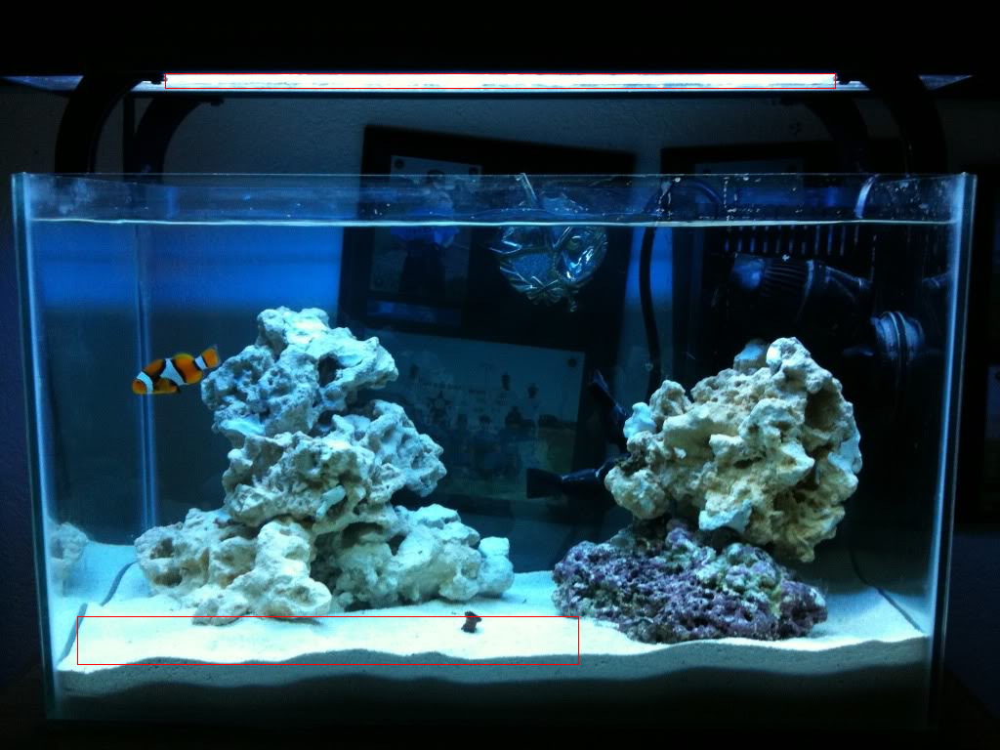

pez023.jpg


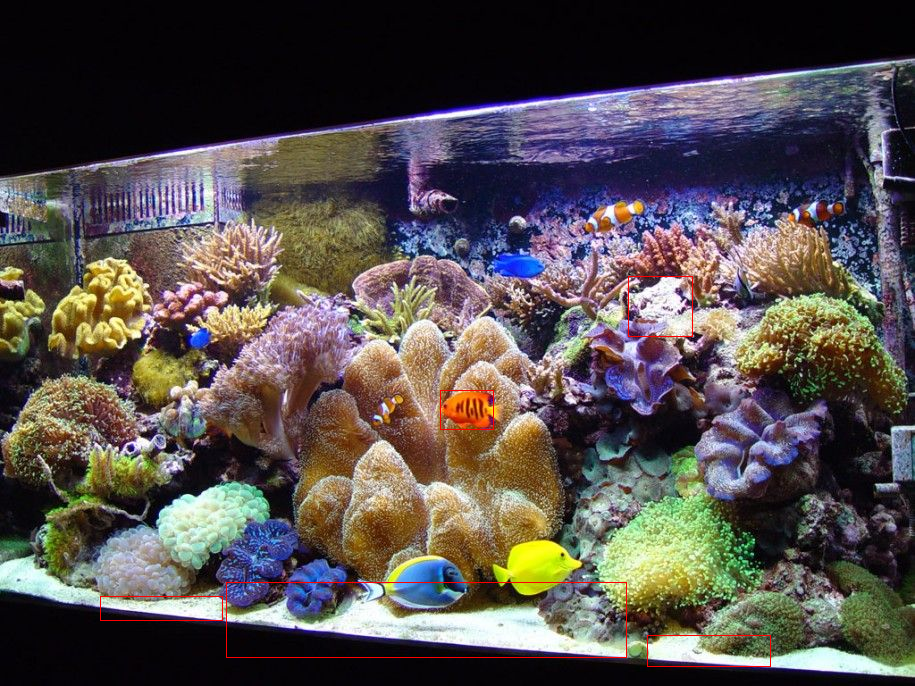

pez024.jpg


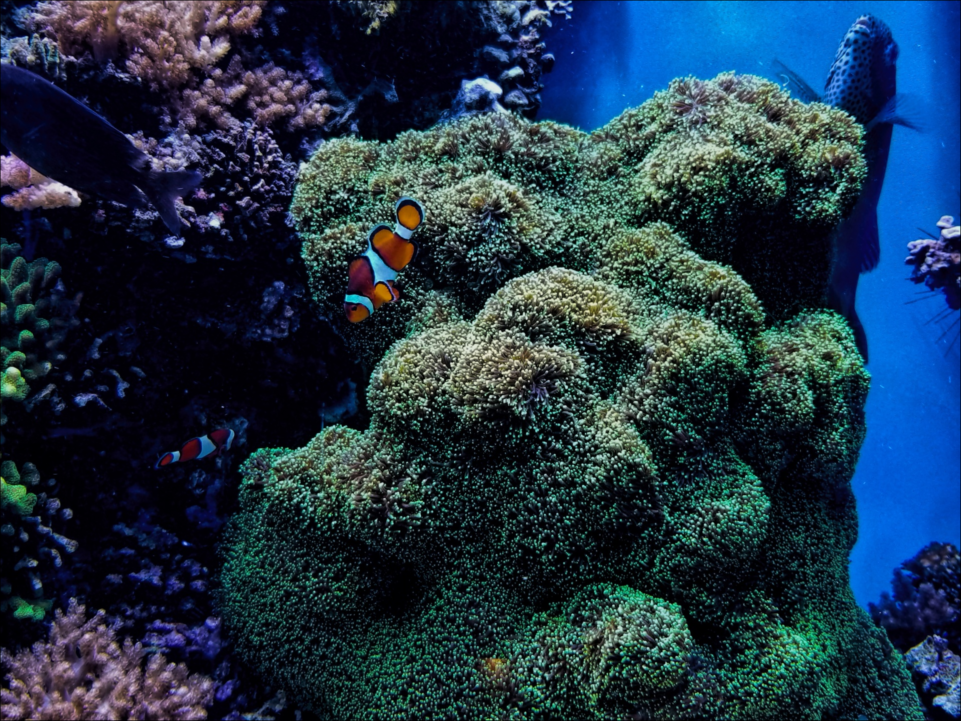

pez025.jpg


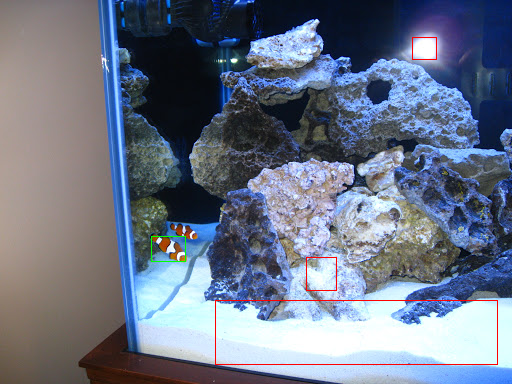

pez026.jpg


In [ ]:
directorio = readdir("../db/fotos");
for file in directorio 
    println(file);
    imagen = process_picture(string("../db/fotos/",file), mejorModelo, 6, 0.72);
    display(imagen)
end; 


# Analisis de Datos y SVM

Parece que mejorModelo.support_vectors_ marca vectores entre pares de features, parece que los pares son de la misma clase.

In [ ]:
using Plots; #plotly() #Con plotly se pueden ver las tres gráficas juntas
gr(size=(800,600))

atr = 1;

x = patrones_si[atr,:];
y = patrones_si[atr+1,:];
z = patrones_si[atr+2,:];

p1 = Plots.scatter(x, y, z,markersize = 2,markercolor = :green)

x = patrones_no[atr,:];
y = patrones_no[atr+1,:];
z = patrones_no[atr+2,:];

p2 = Plots.scatter(x, y, z,markersize = 2,markercolor = :red)

x = mejorModelo.support_vectors_[:,1];
y = mejorModelo.support_vectors_[:,2];
z = mejorModelo.support_vectors_[:,3];

svp = Plots.path3d(x, y, z, color = :blue)

Plots.plot3d(p1,p2,svp)

In [ ]:
k = patrones_si[1,:] + patrones_si[4,:];
l = patrones_si[2,:] - patrones_si[1,:];
m = patrones_si[3,:] - patrones_si[1,:];

p1 = Plots.scatter(k, l, m, markersize = 2, markercolor = :green)

k = patrones_no[1,:] + patrones_no[4,:];
l = patrones_no[2,:] - patrones_no[1,:];
m = patrones_no[3,:] - patrones_no[1,:];

p2 = Plots.scatter(k, l, m, markersize = 2, markercolor = :red)

x = mejorModelo.support_vectors_[:,1] + mejorModelo.support_vectors_[:,4];
y = mejorModelo.support_vectors_[:,2] - mejorModelo.support_vectors_[:,1];
z = mejorModelo.support_vectors_[:,3] - mejorModelo.support_vectors_[:,1];

svp = path3d(x, y, z, color = :blue)

plot(p1,p2,svp)

In [ ]:
using StatsPlots; gr(size=(800,600))

cornerplot(patrones, label = ["R_mean", "G_mean", "B_mean", "R_std" ,"G_std" ,"B_std"])

###### Parecce que las características usadas no son suficientes para realizar una separación clara entre clases


# Histogram of Oriented Gradient (HOG)

Basicamente lo que vamos a hacer ahora es obtener características relevantes de la imagen ignorando las que no interesan como iluminación postura...etc.

In [ ]:
using Images, ImageFeatures

In [ ]:
function prepare_data(dir, output, h_size, w_size, elements)
    directorio = readdir(dir);
    patrones = zeros(Float64, elements, length(directorio))          
    salidas_deseadas = zeros(length(directorio))
    
    i = 1
    for file in directorio 
        image = load(string(dir,"/",file));
        image_new = imresize(image,(h_size, w_size));
        patrones[:,i] = create_descriptor(image_new,HOG());
        salidas_deseadas[i] = output;
        i = i + 1
    end;

    return patrones, salidas_deseadas;
end;

In [ ]:
function shuffle_patterns(patterns, outputs)
    c = hcat(outputs,patterns)
    c = c[shuffle(1:end),:]
    c = c[shuffle(1:end),:]
    return c[:, 2:(size(c)[2])], c[:, 1:1][:,1]
end

In [ ]:
patrones_si, salidas_deseadas_si = prepare_data("positivos", 1, 32, 64, 756);
patrones_no, salidas_deseadas_no = prepare_data("negativos", 0, 32, 64, 756);
println(size(patrones_si))
println(size(salidas_deseadas_si))

In [ ]:
patrones = transpose(hcat(patrones_si, patrones_no))
salidasDeseadas = vcat(salidas_deseadas_si, salidas_deseadas_no)    

patrones


In [ ]:

mejorModelo = svm_training(patrones, salidasDeseadas,"rbf", 0.2, 50, 4);